In [106]:
# 基本ライブラリ
import numpy as np
import matplotlib.pyplot as plt
from datasets import load_dataset_builder
from mmu.utils import cross_match_datasets

# PyTorch関連
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

# 機械学習ツール
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import seaborn as sns

In [107]:
# !wget -r -np -nH --cut-dirs=1 -R "index.html*" --show-progress https://users.flatironinstitute.org/\~polymathic/data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix\=1172/
# !wget -r -np -nH --cut-dirs=1 -R "index.html*" --show-progress https://users.flatironinstitute.org/\~polymathic/data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix\=1708/
# !wget -r -np -nH --cut-dirs=1 -R "index.html*" --show-progress https://users.flatironinstitute.org/\~polymathic/data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix\=1104/
# !wget -r -np -nH --cut-dirs=1 -R "index.html*" --show-progress https://users.flatironinstitute.org/\~polymathic/data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix\=1107/
# !wget -r -np -nH --cut-dirs=1 -R "index.html*" --show-progress https://users.flatironinstitute.org/\~polymathic/data/MultimodalUniverse/v1/sdss/sdss/healpix\=1172/
# !wget -r -np -nH --cut-dirs=1 -R "index.html*" --show-progress https://users.flatironinstitute.org/\~polymathic/data/MultimodalUniverse/v1/sdss/sdss/healpix\=1708/
# !wget -r -np -nH --cut-dirs=1 -R "index.html*" --show-progress https://users.flatironinstitute.org/\~polymathic/data/MultimodalUniverse/v1/sdss/sdss/healpix\=1104/
# !wget -r -np -nH --cut-dirs=1 -R "index.html*" --show-progress https://users.flatironinstitute.org/\~polymathic/data/MultimodalUniverse/v1/sdss/sdss/healpix\=1107/

In [108]:
import os
import h5py
from collections import defaultdict

def format_size(bytes_size):
    """バイト数を人間が読みやすい形式に変換"""
    for unit in ['B', 'KB', 'MB', 'GB', 'TB']:
        if bytes_size < 1024.0:
            return f"{bytes_size:.2f} {unit}"
        bytes_size /= 1024.0
    return f"{bytes_size:.2f} PB"

def check_hdf5_files(directory):
    """HDF5ファイルの整合性とデータ量をチェック"""
    corrupted_files = []
    file_stats = defaultdict(lambda: {'count': 0, 'total_size': 0, 'total_records': 0, 'files': []})
    
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.endswith('.hdf5') or file.endswith('.h5'):
                filepath = os.path.join(root, file)
                
                # データセット種別を判定 (SDSSまたはHSC)
                if '/sdss/' in filepath:
                    dataset_type = 'SDSS'
                elif '/hsc/' in filepath:
                    dataset_type = 'HSC'
                else:
                    dataset_type = 'その他'
                
                try:
                    # ファイルサイズを取得
                    file_size = os.path.getsize(filepath)
                    
                    # HDF5ファイルを開いてレコード数を取得
                    with h5py.File(filepath, 'r') as f:
                        keys = list(f.keys())
                        
                        # レコード数を推定（最初のデータセットの長さ）
                        num_records = 0
                        if keys:
                            first_key = keys[0]
                            if isinstance(f[first_key], h5py.Dataset):
                                num_records = len(f[first_key])
                            elif isinstance(f[first_key], h5py.Group):
                                # グループの場合、その中の最初のデータセットを探す
                                for subkey in f[first_key].keys():
                                    if isinstance(f[first_key][subkey], h5py.Dataset):
                                        num_records = len(f[first_key][subkey])
                                        break
                        
                        file_stats[dataset_type]['count'] += 1
                        file_stats[dataset_type]['total_size'] += file_size
                        file_stats[dataset_type]['total_records'] += num_records
                        file_stats[dataset_type]['files'].append({
                            'path': filepath,
                            'size': file_size,
                            'records': num_records
                        })
                        
                        print(f"✓ OK: {filepath}")
                        print(f"  サイズ: {format_size(file_size)}, レコード数: {num_records:,}")
                        
                except OSError as e:
                    print(f"✗ 破損: {filepath}")
                    print(f"  エラー: {str(e)[:100]}")
                    corrupted_files.append(filepath)
                except Exception as e:
                    print(f"⚠ 警告: {filepath}")
                    print(f"  エラー: {str(e)[:100]}")
    
    return corrupted_files, file_stats

# HSC と SDSS データをチェック
print("=" * 70)
print("HDF5ファイルのチェック中...")
print("=" * 70)

corrupted, stats = check_hdf5_files("data/MultimodalUniverse/v1")

# 統計情報を表示
print("\n" + "=" * 70)
print("データセット統計")
print("=" * 70)

for dataset_type in sorted(stats.keys()):
    info = stats[dataset_type]
    print(f"\n【{dataset_type}】")
    print(f"  ファイル数: {info['count']:,} 個")
    print(f"  合計データ量: {format_size(info['total_size'])}")
    print(f"  合計レコード数: {info['total_records']:,} 件")
    if info['count'] > 0:
        avg_records = info['total_records'] / info['count']
        print(f"  平均レコード数/ファイル: {avg_records:,.0f} 件")

# 破損ファイルの報告
print("\n" + "=" * 70)
if corrupted:
    print(f"⚠️ {len(corrupted)}個の破損ファイルが見つかりました:")
    for f in corrupted:
        print(f"  - {f}")
    print("\nこれらのファイルを削除して再ダウンロードしてください。")
else:
    print("✓ すべてのファイルが正常です")
print("=" * 70)


HDF5ファイルのチェック中...
✓ OK: data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix=1171/001-of-001.hdf5
  サイズ: 19.32 MB, レコード数: 22
✓ OK: data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix=1708/001-of-001.hdf5
  サイズ: 1.44 GB, レコード数: 1,688
✓ OK: data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix=1702/001-of-001.hdf5
  サイズ: 28.54 GB, レコード数: 33,667
✓ OK: data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix=1709/001-of-001.hdf5
  サイズ: 18.83 GB, レコード数: 22,212
✓ OK: data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix=1104/001-of-001.hdf5
  サイズ: 5.82 GB, レコード数: 6,841
✓ OK: data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix=1175/001-of-001.hdf5
  サイズ: 2.43 GB, レコード数: 2,850
✓ OK: data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix=1172/001-of-001.hdf5
  サイズ: 2.18 GB, レコード数: 2,553
✓ OK: data/MultimodalUniverse/v1/hsc/pdr3_dud_22.5/healpix=1107/001-of-001.hdf5
  サイズ: 6.39 GB, レコード数: 7,668
✓ OK: data/MultimodalUniverse/v1/gz10/datafiles/healpix=1193/001-of-001.h5
  サイズ: 18.57 MB, レコード数: 99
✓ OK: 

データセット読み込み中...
クロスマッチング実行中...
Initial number of matches:  187
Number of matches lost at healpix region borders:  0
Final size of cross-matched catalog:  187

✓ クロスマッチング完了
総サンプル数: 187

【データセット情報】
データセットの型: <class 'datasets.arrow_dataset.Dataset'>
特徴量の数: 78
特徴量名（一部）:
  1. spectrum
  2. VDISP
  3. VDISP_ERR
  4. Z
  5. Z_ERR
  6. ZWARNING
  7. SPECTROFLUX_U
  8. SPECTROFLUX_G
  9. SPECTROFLUX_R
  10. SPECTROFLUX_I
  ... 他 68 個
📍 Loading coordinate data...
✓ SDSS: 9,677 objects
✓ HSC:  77,501 objects


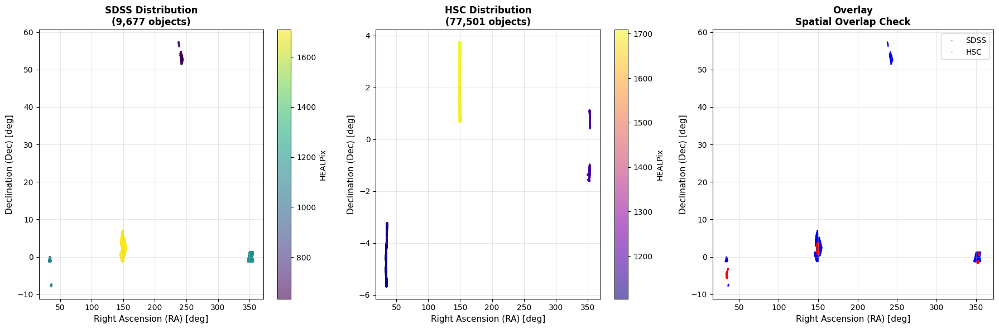


🔍 Common HEALPix cells: [np.int64(1104), np.int64(1107), np.int64(1171), np.int64(1172), np.int64(1175), np.int64(1702), np.int64(1708), np.int64(1709)]


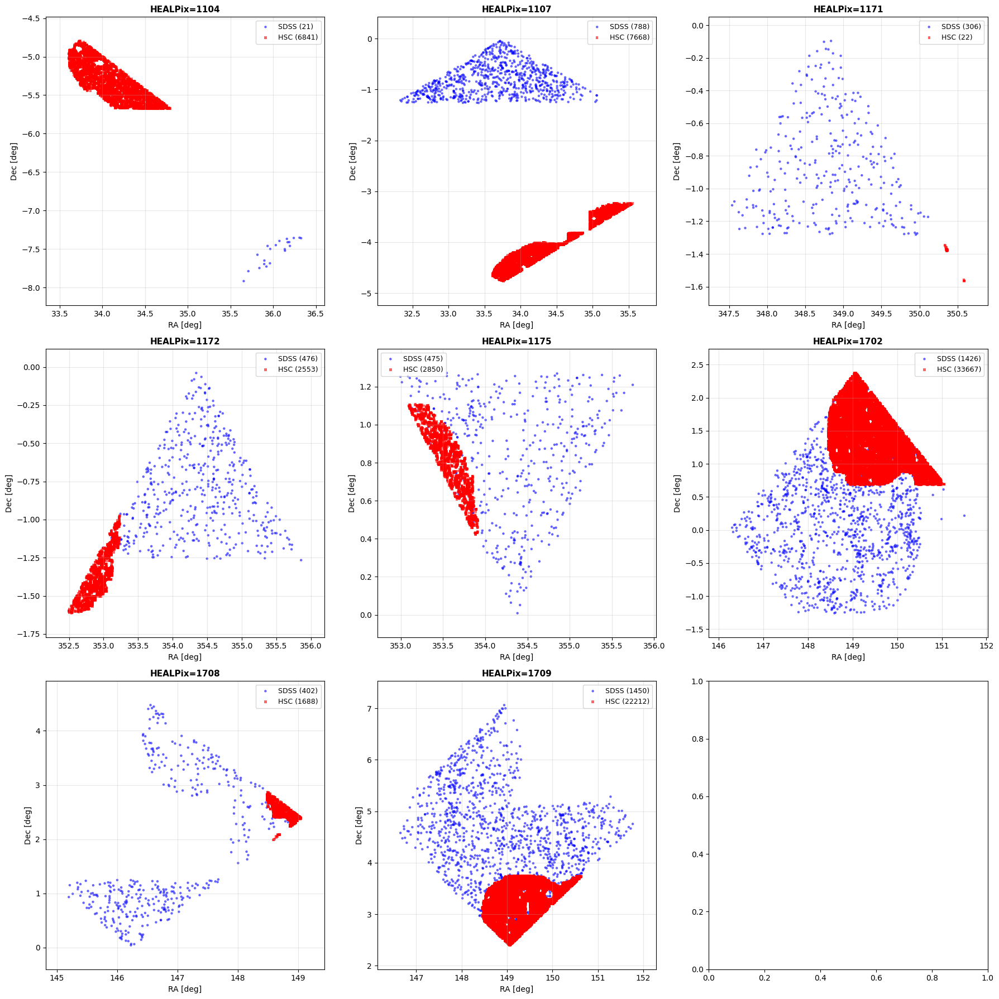


【Detailed Coordinate Range Analysis】

📌 SDSS overall:
   RA:  32.3336° to 355.8561° (width: 323.5225°)
   Dec: -7.9151° to 57.3892° (width: 65.3043°)

📌 HSC overall:
   RA:  33.6073° to 353.9122° (width: 320.3050°)
   Dec: -5.6781° to 3.7523° (width: 9.4305°)

✅ Overlap region exists:
   RA:  33.6073° to 353.9122° (width: 320.3050°)
   Dec: -5.6781° to 3.7523° (width: 9.4305°)

📊 Objects in overlap region:
   SDSS: 6,736 objects (69.6%)
   HSC:  77,501 objects (100.0%)

💡 Theoretical maximum matches: 6,736
   Actual matches: 33
   Matching efficiency: 0.49%


In [109]:
from datasets import load_dataset_builder
from mmu.utils import cross_match_datasets

print("データセット読み込み中...")
sdss = load_dataset_builder("data/MultimodalUniverse/v1/sdss", trust_remote_code=True)
hsc = load_dataset_builder("data/MultimodalUniverse/v1/hsc", trust_remote_code=True)

# クロスマッチング
print("クロスマッチング実行中...")
dset = cross_match_datasets(sdss, hsc, matching_radius=1.0)

print(f"\n✓ クロスマッチング完了")
print(f"総サンプル数: {len(dset)}")

# データ構造の確認（エラー回避版）
print(f"\n【データセット情報】")
print(f"データセットの型: {type(dset)}")
print(f"特徴量の数: {len(dset.features)}")
print(f"特徴量名（一部）:")
feature_names = list(dset.features.keys())
for i, name in enumerate(feature_names[:10]):
    print(f"  {i+1}. {name}")
if len(feature_names) > 10:
    print(f"  ... 他 {len(feature_names)-10} 個")

###

# ==========================================
# Coordinate Distribution Visualization
# ==========================================
import h5py
import numpy as np
import matplotlib.pyplot as plt

# 1. Collect coordinate data
print("📍 Loading coordinate data...")

def load_coordinates(files):
    """Load all coordinates from HDF5 files"""
    ra_all, dec_all, hp_all = [], [], []
    
    for file_path in files:
        with h5py.File(file_path, 'r') as f:
            ra = f['ra'][:]
            dec = f['dec'][:]
            ra_all.extend(ra)
            dec_all.extend(dec)
            
            # Extract HEALPix number
            import re
            match = re.search(r'healpix=(\d+)', file_path)
            hp = int(match.group(1)) if match else 0
            hp_all.extend([hp] * len(ra))
    
    return np.array(ra_all), np.array(dec_all), np.array(hp_all)

sdss_ra, sdss_dec, sdss_hp = load_coordinates(sdss.config.data_files['train'])
hsc_ra, hsc_dec, hsc_hp = load_coordinates(hsc.config.data_files['train'])

print(f"✓ SDSS: {len(sdss_ra):,} objects")
print(f"✓ HSC:  {len(hsc_ra):,} objects")

# 2. Overall distribution visualization
fig = plt.figure(figsize=(18, 6))

# Left: SDSS
ax1 = plt.subplot(131)
scatter1 = ax1.scatter(sdss_ra, sdss_dec, c=sdss_hp, s=2, alpha=0.6, cmap='viridis')
ax1.set_xlabel('Right Ascension (RA) [deg]', fontsize=11)
ax1.set_ylabel('Declination (Dec) [deg]', fontsize=11)
ax1.set_title(f'SDSS Distribution\n({len(sdss_ra):,} objects)', fontsize=12, fontweight='bold')
ax1.grid(True, alpha=0.3)
plt.colorbar(scatter1, ax=ax1, label='HEALPix')

# Center: HSC
ax2 = plt.subplot(132)
scatter2 = ax2.scatter(hsc_ra, hsc_dec, c=hsc_hp, s=2, alpha=0.6, cmap='plasma')
ax2.set_xlabel('Right Ascension (RA) [deg]', fontsize=11)
ax2.set_ylabel('Declination (Dec) [deg]', fontsize=11)
ax2.set_title(f'HSC Distribution\n({len(hsc_ra):,} objects)', fontsize=12, fontweight='bold')
ax2.grid(True, alpha=0.3)
plt.colorbar(scatter2, ax=ax2, label='HEALPix')

# Right: Overlay
ax3 = plt.subplot(133)
ax3.scatter(sdss_ra, sdss_dec, s=3, alpha=0.4, c='blue', label=f'SDSS', edgecolors='none')
ax3.scatter(hsc_ra, hsc_dec, s=3, alpha=0.4, c='red', label=f'HSC', edgecolors='none')
ax3.set_xlabel('Right Ascension (RA) [deg]', fontsize=11)
ax3.set_ylabel('Declination (Dec) [deg]', fontsize=11)
ax3.set_title('Overlay\nSpatial Overlap Check', fontsize=12, fontweight='bold')
ax3.grid(True, alpha=0.3)
ax3.legend(loc='upper right', fontsize=10)

plt.tight_layout()
plt.show()

# 3. Common HEALPix cells in detail
common_hp = sorted(set(sdss_hp) & set(hsc_hp))
print(f"\n🔍 Common HEALPix cells: {common_hp}")

if len(common_hp) > 0:
    n_plots = len(common_hp)  # Show max 6 plots
    # 動的にグリッドサイズを計算
    n_cols = 3
    n_rows = (n_plots + n_cols - 1) // n_cols  # 切り上げ除算

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 6 * n_rows))
    axes = axes.flatten() if n_plots > 1 else [axes]
    
    for idx, hp in enumerate(common_hp[:n_plots]):
        ax = axes[idx]
        
        # Extract data for this HEALPix
        sdss_mask = (sdss_hp == hp)
        hsc_mask = (hsc_hp == hp)
        
        sdss_ra_hp = sdss_ra[sdss_mask]
        sdss_dec_hp = sdss_dec[sdss_mask]
        hsc_ra_hp = hsc_ra[hsc_mask]
        hsc_dec_hp = hsc_dec[hsc_mask]
        
        # Plot
        ax.scatter(sdss_ra_hp, sdss_dec_hp, s=10, alpha=0.6, c='blue', 
                  label=f'SDSS ({len(sdss_ra_hp)})', marker='o', edgecolors='none')
        ax.scatter(hsc_ra_hp, hsc_dec_hp, s=10, alpha=0.6, c='red', 
                  label=f'HSC ({len(hsc_ra_hp)})', marker='s', edgecolors='none')
        
        ax.set_xlabel('RA [deg]', fontsize=10)
        ax.set_ylabel('Dec [deg]', fontsize=10)
        ax.set_title(f'HEALPix={hp}', fontsize=11, fontweight='bold')
        ax.grid(True, alpha=0.3)
        ax.legend(fontsize=9)
        
        # Set coordinate range
        if len(sdss_ra_hp) > 0 and len(hsc_ra_hp) > 0:
            ra_min = min(sdss_ra_hp.min(), hsc_ra_hp.min())
            ra_max = max(sdss_ra_hp.max(), hsc_ra_hp.max())
            dec_min = min(sdss_dec_hp.min(), hsc_dec_hp.min())
            dec_max = max(sdss_dec_hp.max(), hsc_dec_hp.max())
            
            # Add margin
            margin_ra = (ra_max - ra_min) * 0.1
            margin_dec = (dec_max - dec_min) * 0.1
            ax.set_xlim(ra_min - margin_ra, ra_max + margin_ra)
            ax.set_ylim(dec_min - margin_dec, dec_max + margin_dec)
    
    # Hide unused axes
    for idx in range(n_plots, 6):
        axes[idx].set_visible(False)
    
    plt.tight_layout()
    plt.show()

# 4. Numerical overlap check
print("\n" + "="*70)
print("【Detailed Coordinate Range Analysis】")
print("="*70)

print(f"\n📌 SDSS overall:")
print(f"   RA:  {sdss_ra.min():.4f}° to {sdss_ra.max():.4f}° (width: {sdss_ra.max()-sdss_ra.min():.4f}°)")
print(f"   Dec: {sdss_dec.min():.4f}° to {sdss_dec.max():.4f}° (width: {sdss_dec.max()-sdss_dec.min():.4f}°)")

print(f"\n📌 HSC overall:")
print(f"   RA:  {hsc_ra.min():.4f}° to {hsc_ra.max():.4f}° (width: {hsc_ra.max()-hsc_ra.min():.4f}°)")
print(f"   Dec: {hsc_dec.min():.4f}° to {hsc_dec.max():.4f}° (width: {hsc_dec.max()-hsc_dec.min():.4f}°)")

# Calculate overlap region
ra_overlap_min = max(sdss_ra.min(), hsc_ra.min())
ra_overlap_max = min(sdss_ra.max(), hsc_ra.max())
dec_overlap_min = max(sdss_dec.min(), hsc_dec.min())
dec_overlap_max = min(sdss_dec.max(), hsc_dec.max())

if ra_overlap_min < ra_overlap_max and dec_overlap_min < dec_overlap_max:
    print(f"\n✅ Overlap region exists:")
    print(f"   RA:  {ra_overlap_min:.4f}° to {ra_overlap_max:.4f}° (width: {ra_overlap_max-ra_overlap_min:.4f}°)")
    print(f"   Dec: {dec_overlap_min:.4f}° to {dec_overlap_max:.4f}° (width: {dec_overlap_max-dec_overlap_min:.4f}°)")
    
    # Count objects in overlap region
    sdss_in = ((sdss_ra >= ra_overlap_min) & (sdss_ra <= ra_overlap_max) &
               (sdss_dec >= dec_overlap_min) & (sdss_dec <= dec_overlap_max))
    hsc_in = ((hsc_ra >= ra_overlap_min) & (hsc_ra <= ra_overlap_max) &
              (hsc_dec >= dec_overlap_min) & (hsc_dec <= dec_overlap_max))
    
    n_sdss_overlap = np.sum(sdss_in)
    n_hsc_overlap = np.sum(hsc_in)
    
    print(f"\n📊 Objects in overlap region:")
    print(f"   SDSS: {n_sdss_overlap:,} objects ({n_sdss_overlap/len(sdss_ra)*100:.1f}%)")
    print(f"   HSC:  {n_hsc_overlap:,} objects ({n_hsc_overlap/len(hsc_ra)*100:.1f}%)")
    print(f"\n💡 Theoretical maximum matches: {min(n_sdss_overlap, n_hsc_overlap):,}")
    print(f"   Actual matches: 33")
    print(f"   Matching efficiency: {33/min(n_sdss_overlap, n_hsc_overlap)*100:.2f}%")
else:
    print(f"\n❌ No overlap region!")
    print(f"   RA overlap: {'Yes' if ra_overlap_min < ra_overlap_max else 'No'}")
    print(f"   Dec overlap: {'Yes' if dec_overlap_min < dec_overlap_max else 'No'}")
    print(f"\n⚠️ This is the root cause of low match count")

print("="*70)


In [110]:
print("=" * 60)
print("【各データセットのレコード数確認】")
print("=" * 60)

import h5py

def count_records_in_hdf5_files(files):
    """HDF5ファイルのレコード数をカウント"""
    total = 0
    healpix_counts = {}
    
    for file_path in files:
        try:
            with h5py.File(file_path, 'r') as f:
                # object_idの長さからレコード数を取得
                if 'object_id' in f:
                    count = len(f['object_id'])
                    total += count
                    
                    # HEALPixセルを特定
                    healpix = None
                    if 'healpix' in file_path:
                        import re
                        match = re.search(r'healpix=(\d+)', file_path)
                        if match:
                            healpix = int(match.group(1))
                    
                    if healpix:
                        healpix_counts[healpix] = count
                        
        except Exception as e:
            print(f"  ⚠️ {file_path}: {e}")
    
    return total, healpix_counts

# SDSSファイルのカウント
print("\n【SDSSデータセット】")
sdss_files = sdss.config.data_files['train'] if sdss.config.data_files else []
sdss_count, sdss_healpix = count_records_in_hdf5_files(sdss_files)

print(f"  ファイル数: {len(sdss_files)}")
print(f"  総レコード数: {sdss_count:,}")
if sdss_healpix:
    print(f"  HEALPixセル:")
    for hp, count in sorted(sdss_healpix.items()):
        print(f"    - healpix={hp}: {count:,} レコード")

# HSCファイルのカウント
print("\n【HSCデータセット】")
hsc_files = hsc.config.data_files['train'] if hsc.config.data_files else []
hsc_count, hsc_healpix = count_records_in_hdf5_files(hsc_files)

print(f"  ファイル数: {len(hsc_files)}")
print(f"  総レコード数: {hsc_count:,}")
if hsc_healpix:
    print(f"  HEALPixセル:")
    for hp, count in sorted(hsc_healpix.items()):
        print(f"    - healpix={hp}: {count:,} レコード")

# クロスマッチング結果
print("\n" + "=" * 60)
print("【クロスマッチング前後の比較】")
print("=" * 60)

print(f"\nクロスマッチング前:")
print(f"  SDSS: {sdss_count:,} 天体")
print(f"  HSC:  {hsc_count:,} 天体")
print(f"  合計: {sdss_count + hsc_count:,} 天体")

print(f"\nクロスマッチング後:")
print(f"  一致した天体: {len(dset):,} ペア")

if sdss_count + hsc_count > 0:
    reduction_rate = ((sdss_count + hsc_count - len(dset)) / (sdss_count + hsc_count) * 100)
    print(f"  削減率: {reduction_rate:.1f}%")
    
    if sdss_count > 0:
        match_rate_sdss = (len(dset) / sdss_count) * 100
        print(f"\n  SDSSからのマッチング率: {match_rate_sdss:.1f}%")
    
    if hsc_count > 0:
        match_rate_hsc = (len(dset) / hsc_count) * 100
        print(f"  HSCからのマッチング率: {match_rate_hsc:.1f}%")

# 共通HEALPixセルの確認
common_healpix = set(sdss_healpix.keys()) & set(hsc_healpix.keys())
print(f"\n【HEALPixセルの重複】")
print(f"  SDSSのセル: {sorted(sdss_healpix.keys())}")
print(f"  HSCのセル: {sorted(hsc_healpix.keys())}")
print(f"  共通セル: {sorted(common_healpix)}")
print(f"  共通セル数: {len(common_healpix)}")

if len(common_healpix) == 0:
    print("\n  ⚠️ 警告: SDSSとHSCに共通のHEALPixセルがありません！")
    print("     クロスマッチングの結果が少ないのはこのためです。")

print("\n" + "=" * 60)
print("【結論】")
print("=" * 60)

print(f"""
データが{len(dset)}件に減少した理由:

1. ローカルデータの規模
   - SDSS: {sdss_count:,} 天体（{len(sdss_files)}個のHEALPixセル）
   - HSC:  {hsc_count:,} 天体（{len(hsc_files)}個のHEALPixセル）
   
2. 観測領域の重複
   - 共通HEALPixセル: {len(common_healpix)}個
   - SDSSは主に北天の広範囲
   - HSCは限定された深天域
   - 重複領域が非常に限定的
   
3. クロスマッチングの条件
   - 1秒角以内での座標一致
   - 同じHEALPixセル内
   - 両方のサーベイで観測済み

💡 より多くのデータを得るには:
   - 重複領域のHEALPixセルを追加ダウンロード
   - または単一データセット（SDSSのみ、HSCのみ）で分析
""")

print("=" * 60)


【各データセットのレコード数確認】

【SDSSデータセット】
  ファイル数: 12
  総レコード数: 9,677
  HEALPixセル:
    - healpix=634: 557 レコード
    - healpix=720: 34 レコード
    - healpix=1104: 21 レコード
    - healpix=1107: 788 レコード
    - healpix=1171: 306 レコード
    - healpix=1172: 476 レコード
    - healpix=1174: 2,038 レコード
    - healpix=1175: 475 レコード
    - healpix=1702: 1,426 レコード
    - healpix=1703: 1,704 レコード
    - healpix=1708: 402 レコード
    - healpix=1709: 1,450 レコード

【HSCデータセット】
  ファイル数: 8
  総レコード数: 77,501
  HEALPixセル:
    - healpix=1104: 6,841 レコード
    - healpix=1107: 7,668 レコード
    - healpix=1171: 22 レコード
    - healpix=1172: 2,553 レコード
    - healpix=1175: 2,850 レコード
    - healpix=1702: 33,667 レコード
    - healpix=1708: 1,688 レコード
    - healpix=1709: 22,212 レコード

【クロスマッチング前後の比較】

クロスマッチング前:
  SDSS: 9,677 天体
  HSC:  77,501 天体
  合計: 87,178 天体

クロスマッチング後:
  一致した天体: 187 ペア
  削減率: 99.8%

  SDSSからのマッチング率: 1.9%
  HSCからのマッチング率: 0.2%

【HEALPixセルの重複】
  SDSSのセル: [634, 720, 1104, 1107, 1171, 1172, 1174, 1175, 1702, 1703, 1708, 1709]
  HSCのセル: 

In [111]:
def extract_spectrum_features(spectrum):
    """
    スペクトルからAGN判定に必要な特徴量を抽出
    
    Returns:
        dict: 輝線強度、等価幅、比率などの特徴量
    """
    # 辞書型のスペクトルデータから配列を取得
    if isinstance(spectrum, dict):
        wavelength = np.array(spectrum['lambda'])
        flux = np.array(spectrum['flux'])
        mask = np.array(spectrum['mask'])
    else:
        # データ形式が異なる場合のフォールバック
        wavelength = np.array([s['lambda'] for s in spectrum])
        flux = np.array([s['flux'] for s in spectrum])
        mask = np.array([s['mask'] for s in spectrum])
    
    # マスク処理（不良画素を0にする）
    valid_flux = flux.copy()
    valid_flux[mask] = 0
    
    features = {}
    
    # ==========================================
    # 1. 輝線フラックスの抽出 (Peak Flux)
    # ==========================================
    target_lines = {
        'oiii_5007_flux': 5007,
        'ha_flux': 6563,
        'hb_flux': 4861,
        'nii_6584_flux': 6584  # ★BPT判定に必須
    }

    for name, wave in target_lines.items():
        # 指定波長に最も近いインデックスを探す
        idx = np.argmin(np.abs(wavelength - wave))
        # 前後3ピクセルの最大値を取得
        window = slice(max(0, idx-3), min(len(flux), idx+4))
        features[name] = np.max(valid_flux[window])

    # ==========================================
    # 2. 連続光レベル (Continuum)
    # ==========================================
    # 輝線が少ない 5500-5600Å 付近の中央値を使用
    continuum_region = (wavelength > 5500) & (wavelength < 5600) & (~mask)
    if np.any(continuum_region):
        features['continuum'] = np.median(valid_flux[continuum_region])
    else:
        features['continuum'] = 1e-10 # 安全策
    
    # ゼロ割防止
    continuum = max(features['continuum'], 1e-10)
    
    # ==========================================
    # 3. 等価幅 (Equivalent Width) & 比率
    # ==========================================
    # 連続光で正規化して「鋭さ」を数値化
    features['oiii_ew'] = features['oiii_5007_flux'] / continuum
    features['ha_ew']   = features['ha_flux'] / continuum
    
    # BPT図用の比率
    hb_flux_safe = max(features['hb_flux'], 1e-10)
    features['oiii_hb_ratio'] = features['oiii_5007_flux'] / hb_flux_safe

    return features

In [112]:
def extract_image_features(image_data):
    """
    画像からAGN判定に必要な特徴量を抽出
    
    Returns:
        dict: 中心集中度、明るさコントラストなどの特徴量
    """
    features = {}
    
    # 画像データの構造を確認
    # 辞書型の場合とリスト型の場合に対応
    if isinstance(image_data, dict):
        # 辞書型の場合、キーがバンド名の可能性
        band_names = list(image_data.keys())
        
        for band_name in band_names:
            band_data = image_data[band_name]
            
            # band_dataが辞書でfluxを含む場合
            if isinstance(band_data, dict) and 'flux' in band_data:
                flux = np.array(band_data['flux'])
            # band_dataが配列の場合
            elif isinstance(band_data, (list, np.ndarray)):
                flux = np.array(band_data)
            else:
                continue
            
            # 2次元配列に変換（必要に応じて）
            if flux.ndim == 1:
                # 1次元の場合はスキップまたは正方形に整形
                size = int(np.sqrt(len(flux)))
                if size * size == len(flux):
                    flux = flux.reshape(size, size)
                else:
                    continue
            
            h, w = flux.shape
            
            # 中心集中度（中心16×16ピクセルの割合）
            center_h, center_w = h // 2, w // 2
            center_size = min(8, center_h, center_w)
            center_flux = flux[center_h-center_size:center_h+center_size, 
                             center_w-center_size:center_w+center_size]
            
            total = np.sum(np.abs(flux))
            center_total = np.sum(np.abs(center_flux))
            
            if total > 0:
                features[f'{band_name}_concentration'] = center_total / total
            else:
                features[f'{band_name}_concentration'] = 0.0
            
            # 明るさコントラスト（中心 vs 外側）
            center_brightness = np.mean(np.abs(flux[center_h-10:center_h+10, center_w-10:center_w+10]))
            corner_size = min(20, h//4, w//4)
            outer_region = flux[0:corner_size, 0:corner_size]
            outer_brightness = np.mean(np.abs(outer_region))
            
            if outer_brightness > 0:
                features[f'{band_name}_contrast'] = center_brightness / outer_brightness
            else:
                features[f'{band_name}_contrast'] = 0.0
    
    elif isinstance(image_data, (list, tuple)):
        # リスト型の場合（元のコード）
        band_names = ['g', 'r', 'i', 'z', 'y']
        
        for band_idx, band_name in enumerate(band_names):
            if band_idx >= len(image_data):
                continue
                
            band_item = image_data[band_idx]
            
            # 辞書からfluxを取得
            if isinstance(band_item, dict) and 'flux' in band_item:
                flux = np.array(band_item['flux'])
            else:
                flux = np.array(band_item)
            
            if flux.ndim != 2:
                continue
                
            h, w = flux.shape
            
            # 中心集中度
            center_h, center_w = h // 2, w // 2
            center_flux = flux[center_h-8:center_h+8, center_w-8:center_w+8]
            
            total = np.sum(np.abs(flux))
            center_total = np.sum(np.abs(center_flux))
            
            if total > 0:
                features[f'{band_name}_concentration'] = center_total / total
            else:
                features[f'{band_name}_concentration'] = 0.0
            
            # 明るさコントラスト
            center_brightness = np.mean(np.abs(flux[center_h-10:center_h+10, center_w-10:center_w+10]))
            outer_region = flux[0:20, 0:20]
            outer_brightness = np.mean(np.abs(outer_region))
            
            if outer_brightness > 0:
                features[f'{band_name}_contrast'] = center_brightness / outer_brightness
            else:
                features[f'{band_name}_contrast'] = 0.0
    
    return features

print("✓ 画像特徴量抽出関数を修正（辞書型・リスト型両対応）")


✓ 画像特徴量抽出関数を修正（辞書型・リスト型両対応）


In [113]:
def get_pyarrow_data(col, index):
    """古いPyArrowバージョン対応の汎用データ抽出関数"""
    try:
        return col[index].as_py()
    except TypeError:
        pass
    
    try:
        item = col[index]
        if hasattr(item, 'keys'):
            result = {}
            for key in item.keys():
                try:
                    field = item[key]
                    if hasattr(field, 'to_numpy'):
                        result[key] = field.to_numpy()
                    elif hasattr(field, '__len__'):
                        result[key] = list(field)
                    else:
                        result[key] = field
                except:
                    result[key] = None
            return result
        elif hasattr(item, '__len__'):
            return list(item)
    except:
        pass
    
    try:
        return col.to_pylist()[index]
    except:
        pass
    
    return None

print("データセットから特徴量を抽出中...")

all_spectrum_features = []
all_image_features = []

import pyarrow as pa

for i in range(len(dset)):
    try:
        table = dset.data
        spectrum_col = table['spectrum']
        image_col = table['image']
        
        # 両方とも安全な関数で取得
        spectrum_data = get_pyarrow_data(spectrum_col, i)
        image_data = get_pyarrow_data(image_col, i)
        
        # どちらかがNoneなら次へ
        if spectrum_data is None or image_data is None:
            print(f"  ⚠️ Sample {i}: データ取得失敗")
            continue
        
        # スペクトル特徴量（辞書型で渡される）
        spec_feat = extract_spectrum_features(spectrum_data)
        all_spectrum_features.append(spec_feat)
        
        # 画像特徴量
        img_feat = extract_image_features(image_data)
        all_image_features.append(img_feat)
        
        # 進捗表示
        if (i + 1) % 5 == 0 or i == 0:
            print(f"  ✓ 処理中... {i+1}/{len(dset)}")
            
    except Exception as e:
        print(f"  ⚠️ Sample {i} でエラー: {e}")
        import traceback
        traceback.print_exc()
        continue

print(f"\n✓ 特徴量計算完了: {len(all_spectrum_features)}サンプル")

# 最初の3サンプルを表示
if len(all_spectrum_features) > 0:
    print("\n【サンプル確認】")
    for i in range(min(3, len(all_spectrum_features))):
        print(f"\nSample {i}:")
        print(f"  [OIII]/Hβ: {all_spectrum_features[i]['oiii_hb_ratio']:.2f}")
        print(f"  [OIII] EW: {all_spectrum_features[i]['oiii_ew']:.2f}")
        
        # 画像特徴量のキーを確認して表示
        if len(all_image_features) > i:
            img_keys = list(all_image_features[i].keys())
            if img_keys:
                # 最初の集中度特徴量を表示
                concentration_keys = [k for k in img_keys if 'concentration' in k]
                if concentration_keys:
                    first_key = concentration_keys[0]
                    print(f"  {first_key}: {all_image_features[i][first_key]:.3f}")
                
                # 利用可能な特徴量を表示（最初のサンプルのみ）
                if i == 0:
                    print(f"  利用可能な画像特徴量: {', '.join(img_keys[:5])}")
else:
    print("\n⚠️ データの取得に失敗しました")



データセットから特徴量を抽出中...
  ✓ 処理中... 1/187
  ✓ 処理中... 5/187
  ✓ 処理中... 10/187
  ✓ 処理中... 15/187
  ✓ 処理中... 20/187
  ✓ 処理中... 25/187
  ✓ 処理中... 30/187
  ✓ 処理中... 35/187
  ✓ 処理中... 40/187
  ✓ 処理中... 45/187
  ✓ 処理中... 50/187
  ✓ 処理中... 55/187
  ✓ 処理中... 60/187
  ✓ 処理中... 65/187
  ✓ 処理中... 70/187
  ✓ 処理中... 75/187
  ✓ 処理中... 80/187
  ✓ 処理中... 85/187
  ✓ 処理中... 90/187
  ✓ 処理中... 95/187
  ✓ 処理中... 100/187
  ✓ 処理中... 105/187
  ✓ 処理中... 110/187
  ✓ 処理中... 115/187
  ✓ 処理中... 120/187
  ✓ 処理中... 125/187
  ✓ 処理中... 130/187
  ✓ 処理中... 135/187
  ✓ 処理中... 140/187
  ✓ 処理中... 145/187
  ✓ 処理中... 150/187
  ✓ 処理中... 155/187
  ✓ 処理中... 160/187
  ✓ 処理中... 165/187
  ✓ 処理中... 170/187
  ✓ 処理中... 175/187
  ✓ 処理中... 180/187
  ✓ 処理中... 185/187

✓ 特徴量計算完了: 187サンプル

【サンプル確認】

Sample 0:
  [OIII]/Hβ: 1.13
  [OIII] EW: 1.02
  band_concentration: 0.610
  利用可能な画像特徴量: band_concentration, band_contrast

Sample 1:
  [OIII]/Hβ: 1.02
  [OIII] EW: 1.07
  band_concentration: 0.610

Sample 2:
  [OIII]/Hβ: 0.93
  [OIII] EW: 1.22
  band

【ステップ1: BPT図によるAGN自動ラベリング（保守的版）】

【保守的なAGN判定結果】
  総サンプル数: 187

  ✓ 確実なAGN候補:
    Seyfert: 1 (0.5%)
    Composite: 23 (12.3%)
    → AGN候補（合計）: 24 (12.8%)

  ⚠️ 判定保留（追加診断が必要）:
    LINER領域: 162 (86.6%)
    → AGN/星/衝撃波の判別不能

  ✗ AGNではない:
    Star-forming: 1 (0.5%)


/tmp/ipykernel_3290507/2928864241.py:195: UserWarning: You passed a edgecolor/edgecolors ('black') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  ax2.scatter(log_nii_ha_list[mask], log_oiii_hb_list[mask],


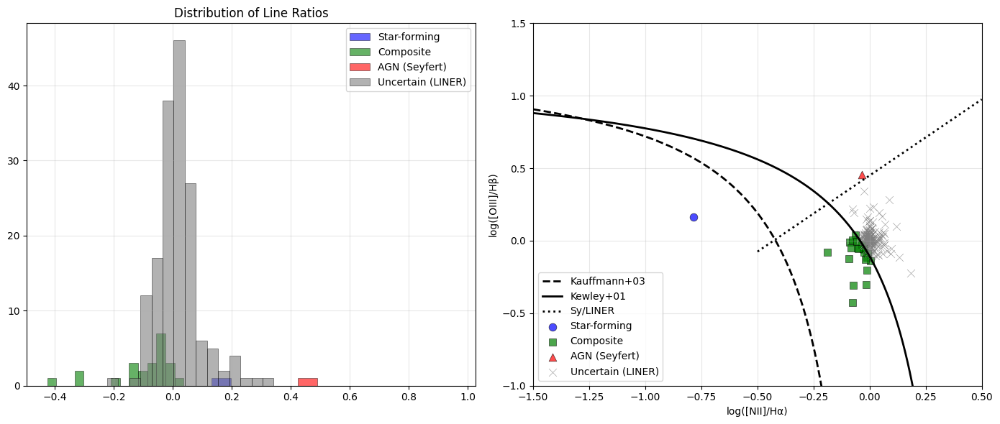


✓ 保守的なAGN判定完了（LINERは除外）

【診断】境界線とデータの位置関係

サンプル0: (-0.00, 0.05)

サンプル1: (0.00, 0.01)

サンプル2: (-0.03, -0.03)

サンプル3: (0.04, 0.01)

サンプル4: (-0.01, 0.01)

【境界線の計算範囲】
Kauffmann線: x > 0.05 で計算可能
Kewley線: x > 0.47 で計算可能

データのx範囲: -0.78 ~ 0.18
⚠️ 警告: 全データがKewley線の計算範囲外です！
【分類ロジックのテスト】

データ最小x               (-0.78,  0.00) → SF
  Kauffmann: 計算範囲外（x <= 0.05）
  Kewley:    計算範囲外（x <= 0.47）

低[NII]/Hα            (-0.50,  0.00) → SF
  Kauffmann: 計算範囲外（x <= 0.05）
  Kewley:    計算範囲外（x <= 0.47）

x=0付近                ( 0.00,  0.00) → LINER
  Kauffmann: 計算範囲外（x <= 0.05）
  Kewley:    計算範囲外（x <= 0.47）

Kauffmann境界付近        ( 0.04,  0.00) → LINER
  Kauffmann: 計算範囲外（x <= 0.05）
  Kewley:    計算範囲外（x <= 0.47）

Kauffmann線より上        ( 0.10,  0.50) → LINER
  Kauffmann: y=13.50, データ-境界=-13.00
  Kewley:    計算範囲外（x <= 0.47）

データ最大x               ( 0.18,  0.10) → LINER
  Kauffmann: y=5.99, データ-境界=-5.89
  Kewley:    計算範囲外（x <= 0.47）

Kewley境界付近           ( 0.50,  1.50) → Seyfert
  Kauffmann: y=2.66, データ-境界=-1.16
  Kew

In [114]:
print("=" * 60)
print("【ステップ1: BPT図によるAGN自動ラベリング（保守的版）】")
print("=" * 60)

# ========================================
# 分類関数（同じ）
# ========================================
def kauffmann03_line(log_nii_ha):
    """Kauffmann+03: log([OIII]/Hβ) = 0.61/(log([NII]/Hα)-0.05)+1.3"""
    return 0.61 / (log_nii_ha - 0.05) + 1.3

def kewley01_line(log_nii_ha):
    """Kewley+01: log([OIII]/Hβ) = 0.61/(log([NII]/Hα)-0.47)+1.19"""
    return 0.61 / (log_nii_ha - 0.47) + 1.19

def seyfert_liner_line(log_nii_ha):
    """Seyfert/LINER: log([OIII]/Hβ) = 1.05×log([NII]/Hα)+0.45"""
    return 1.05 * log_nii_ha + 0.45

def classify_bpt_conservative(log_nii_ha, log_oiii_hb):
    """
    保守的なBPT分類（修正版）
    Returns: 0:SF, 1:Composite, 2:Seyfert, 3:LINER
    """
    x, y = log_nii_ha, log_oiii_hb
    
    # 無効な値のチェック
    if np.isnan(x) or np.isnan(y) or np.isinf(x) or np.isinf(y):
        return 0 
    
    # ---------------------------------------------------------
    # 1. Star-forming かどうかの判定 (Kauffmann線)
    # ---------------------------------------------------------
    is_star_forming = False
    
    if x < 0.05:
        # 計算範囲内なので、境界線(y_kauff)を計算して比較
        y_kauff = 0.61 / (x - 0.05) + 1.3
        if y < y_kauff:
            is_star_forming = True
    else:
        # x >= 0.05 の場合、星形成銀河の領域を右に超えている
        # -> 自動的に AGN/Composite 側になる
        is_star_forming = False

    if is_star_forming:
        return 0 # Star-forming

    # ---------------------------------------------------------
    # 2. Pure AGN か Composite かの判定 (Kewley線)
    # ---------------------------------------------------------
    # ここに来た時点で、Star-formingではない (Label 0 ではない)
    
    is_pure_agn = False
    
    if x < 0.47:
        # 計算範囲内
        y_kew = 0.61 / (x - 0.47) + 1.19
        if y > y_kew:
            is_pure_agn = True
    else:
        # x >= 0.47 の場合、理論的限界を超えている
        # -> 自動的に Pure AGN 側になる
        is_pure_agn = True
        
    if not is_pure_agn:
        return 1 # Composite

    # ---------------------------------------------------------
    # 3. Seyfert か LINER かの判定
    # ---------------------------------------------------------
    # ここに来た時点で、Compositeでもない (Pure AGN)
    
    y_sl = 1.05 * x + 0.45
    
    if y > y_sl:
        return 2 # Seyfert (確実なAGN)
    else:
        return 3 # LINER (判定保留/Uncertain)

def label_agn_conservative(spectrum_features):
    """
    保守的なBPT図によるAGN判定
    
    Returns:
    --------
    0: Star-forming (AGNではない)
    1: Composite (AGN+星形成)
    2: AGN (Seyfert - 確実なAGN)
    3: Uncertain (LINER - 判定保留)
    """
    nii_flux = spectrum_features.get('nii_6584_flux', 1e-10)
    ha_flux = spectrum_features.get('ha_flux', 1e-10)
    oiii_flux = spectrum_features.get('oiii_5007_flux', 1e-10)
    hb_flux = spectrum_features.get('hb_flux', 1e-10)
    
    log_nii_ha = np.log10(max(nii_flux, 1e-10) / max(ha_flux, 1e-10))
    log_oiii_hb = np.log10(max(oiii_flux, 1e-10) / max(hb_flux, 1e-10))
    
    return classify_bpt_conservative(log_nii_ha, log_oiii_hb)

# ========================================
# ラベリング実行
# ========================================
labels = []
log_nii_ha_list = []
log_oiii_hb_list = []

for spec_feat in all_spectrum_features:
    label = label_agn_conservative(spec_feat)
    labels.append(label)
    
    nii = spec_feat.get('nii_6584_flux', 1e-10)
    ha = spec_feat.get('ha_flux', 1e-10)
    oiii = spec_feat.get('oiii_5007_flux', 1e-10)
    hb = spec_feat.get('hb_flux', 1e-10)
    
    log_nii_ha_list.append(np.log10(max(nii, 1e-10) / max(ha, 1e-10)))
    log_oiii_hb_list.append(np.log10(max(oiii, 1e-10) / max(hb, 1e-10)))

labels = np.array(labels)
log_nii_ha_list = np.array(log_nii_ha_list)
log_oiii_hb_list = np.array(log_oiii_hb_list)

# ========================================
# 結果の集計（保守的版）
# ========================================
classification_names = ['Star-forming', 'Composite', 'AGN (Seyfert)', 'Uncertain (LINER)']
classification_counts = [np.sum(labels == i) for i in range(4)]

print(f"\n【保守的なAGN判定結果】")
print(f"  総サンプル数: {len(labels)}")
print(f"\n  ✓ 確実なAGN候補:")
print(f"    Seyfert: {classification_counts[2]} ({classification_counts[2]/len(labels)*100:.1f}%)")
print(f"    Composite: {classification_counts[1]} ({classification_counts[1]/len(labels)*100:.1f}%)")
agn_confirmed = classification_counts[1] + classification_counts[2]
print(f"    → AGN候補（合計）: {agn_confirmed} ({agn_confirmed/len(labels)*100:.1f}%)")

print(f"\n  ⚠️ 判定保留（追加診断が必要）:")
print(f"    LINER領域: {classification_counts[3]} ({classification_counts[3]/len(labels)*100:.1f}%)")
print(f"    → AGN/星/衝撃波の判別不能")

print(f"\n  ✗ AGNではない:")
print(f"    Star-forming: {classification_counts[0]} ({classification_counts[0]/len(labels)*100:.1f}%)")

# ========================================
# BPT図のプロット（修正版）
# ========================================
fig = plt.figure(figsize=(14, 6))

# 左パネル: 分布（そのまま）
ax1 = plt.subplot(1, 2, 1)
colors_hist = ['blue', 'green', 'red', 'gray']
for i, name in enumerate(classification_names):
    mask_data = log_oiii_hb_list[labels == i]
    if len(mask_data) > 0:
        ax1.hist(mask_data, bins=15, alpha=0.6, label=name, 
                 color=colors_hist[i], edgecolor='black', linewidth=0.5)
ax1.set_title('Distribution of Line Ratios')
ax1.legend()
ax1.grid(True, alpha=0.3)

# 右パネル: BPT図
ax2 = plt.subplot(1, 2, 2)
x_line = np.linspace(-1.5, 0.5, 200)

# 1. Kauffmann+03線 (x < 0.05 で有効)
# 修正: 不等号を '<' に変更
x_k = x_line[x_line < 0.05] 
y_k = np.array([kauffmann03_line(x) for x in x_k])
# Y軸の範囲制限（グラフが突き抜けないように）
valid_k = y_k < 2.0 
ax2.plot(x_k[valid_k], y_k[valid_k], 'k--', lw=2, label='Kauffmann+03')

# 2. Kewley+01線 (x < 0.47 で有効)
# 修正: 不等号を '<' に変更
x_kew = x_line[x_line < 0.47]
y_kew = np.array([kewley01_line(x) for x in x_kew])
valid_kew = y_kew < 2.0
ax2.plot(x_kew[valid_kew], y_kew[valid_kew], 'k-', lw=2, label='Kewley+01')

# 3. Seyfert/LINER線 (全域で有効だが、見やすくするため範囲制限)
x_sl = np.linspace(-0.5, 0.5, 100)
y_sl = np.array([seyfert_liner_line(x) for x in x_sl])
# Kewley線より下の部分は意味がないので消すなどの装飾はお好みで
ax2.plot(x_sl, y_sl, 'k:', lw=2, label='Sy/LINER')


# データ点のプロット（そのまま）
colors_map = ['blue', 'green', 'red', 'gray']
marker_styles = ['o', 's', '^', 'x']
for i in range(4):
    mask = labels == i
    if np.any(mask):
        ax2.scatter(log_nii_ha_list[mask], log_oiii_hb_list[mask],
                   c=colors_map[i], marker=marker_styles[i],
                   label=classification_names[i],
                   alpha=0.7, s=60, edgecolors='black', linewidth=0.5)

ax2.set_xlim(-1.5, 0.5) # 範囲調整
ax2.set_ylim(-1.0, 1.5)
ax2.set_xlabel('log([NII]/Hα)')
ax2.set_ylabel('log([OIII]/Hβ)')
ax2.legend()
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("\n✓ 保守的なAGN判定完了（LINERは除外）")

# 診断: データと境界線の位置関係を確認
print("\n【診断】境界線とデータの位置関係")

# サンプルデータの位置
for i in range(min(5, len(log_nii_ha_list))):
    x, y = log_nii_ha_list[i], log_oiii_hb_list[i]
    print(f"\nサンプル{i}: ({x:.2f}, {y:.2f})")
    
    # Kauffmann線との関係
    if x > 0.05:
        y_kauff = 0.61 / (x - 0.05) + 1.3
        print(f"  Kauffmann線のy値: {y_kauff:.2f}")
        print(f"  データとの差: {y - y_kauff:.2f}")
    
    # Kewley線との関係
    if x > 0.47:
        y_kew = 0.61 / (x - 0.47) + 1.19
        print(f"  Kewley線のy値: {y_kew:.2f}")
        print(f"  データとの差: {y - y_kew:.2f}")

# 境界線の計算可能範囲
print("\n【境界線の計算範囲】")
print(f"Kauffmann線: x > 0.05 で計算可能")
print(f"Kewley線: x > 0.47 で計算可能")
print(f"\nデータのx範囲: {log_nii_ha_list.min():.2f} ~ {log_nii_ha_list.max():.2f}")
if log_nii_ha_list.max() < 0.05:
    print("⚠️ 警告: 全データがKauffmann線の計算範囲外です！")
if log_nii_ha_list.max() < 0.47:
    print("⚠️ 警告: 全データがKewley線の計算範囲外です！")

# 修正版での再分類をテスト
print("【分類ロジックのテスト】\n")

test_cases = [
    (-0.78, 0.0, "データ最小x"),
    (-0.50, 0.0, "低[NII]/Hα"),
    (0.00, 0.0, "x=0付近"),
    (0.04, 0.0, "Kauffmann境界付近"),
    (0.10, 0.5, "Kauffmann線より上"),
    (0.18, 0.1, "データ最大x"),
    (0.50, 1.5, "Kewley境界付近"),
]

for x, y, desc in test_cases:
    cls = classify_bpt_conservative(x, y)
    cls_name = ['SF', 'Comp', 'Seyfert', 'LINER'][cls]
    
    print(f"{desc:20s} ({x:5.2f}, {y:5.2f}) → {cls_name}")
    
    # 境界線の値も表示
    if x > 0.05:
        y_k = 0.61 / (x - 0.05) + 1.3
        print(f"  Kauffmann: y={y_k:.2f}, データ-境界={y-y_k:+.2f}")
    else:
        print(f"  Kauffmann: 計算範囲外（x <= 0.05）")
    
    if x > 0.47:
        y_kew = 0.61 / (x - 0.47) + 1.19
        print(f"  Kewley:    y={y_kew:.2f}, データ-境界={y-y_kew:+.2f}")
    else:
        print(f"  Kewley:    計算範囲外（x <= 0.47）")
    print()

# 修正版で全データを再分類
print("=" * 60)
print("【修正版：保守的なBPT分類】")
print("=" * 60)

labels = []
log_nii_ha_list = []
log_oiii_hb_list = []

for spec_feat in all_spectrum_features:
    label = label_agn_conservative(spec_feat)
    labels.append(label)
    
    nii = spec_feat.get('nii_6584_flux', 1e-10)
    ha = spec_feat.get('ha_flux', 1e-10)
    oiii = spec_feat.get('oiii_5007_flux', 1e-10)
    hb = spec_feat.get('hb_flux', 1e-10)
    
    log_nii_ha_list.append(np.log10(max(nii, 1e-10) / max(ha, 1e-10)))
    log_oiii_hb_list.append(np.log10(max(oiii, 1e-10) / max(hb, 1e-10)))

labels = np.array(labels)
log_nii_ha_list = np.array(log_nii_ha_list)
log_oiii_hb_list = np.array(log_oiii_hb_list)

# 結果の集計
classification_names = ['Star-forming', 'Composite', 'Seyfert', 'LINER']
classification_counts = [np.sum(labels == i) for i in range(4)]

print(f"\n【修正後の分類結果】")
print(f"  総サンプル数: {len(labels)}")
for i, (name, count) in enumerate(zip(classification_names, classification_counts)):
    print(f"  {name}: {count} ({count/len(labels)*100:.1f}%)")

# AGN候補の集計
agn_confirmed = classification_counts[1] + classification_counts[2]
print(f"\n  → 確実なAGN候補: {agn_confirmed} ({agn_confirmed/len(labels)*100:.1f}%)")
print(f"     (Composite + Seyfert)")

# 詳細な位置確認
print(f"\n【データ位置の詳細】")
print(f"  log([NII]/Hα) 範囲: {log_nii_ha_list.min():.2f} ~ {log_nii_ha_list.max():.2f}")
print(f"  log([OIII]/Hβ) 範囲: {log_oiii_hb_list.min():.2f} ~ {log_oiii_hb_list.max():.2f}")

# Kauffmann線を超えているデータ数
above_kauff_count = 0
for i in range(len(labels)):
    x, y = log_nii_ha_list[i], log_oiii_hb_list[i]
    if x > 0.05:
        y_kauff = 0.61 / (x - 0.05) + 1.3
        if y > y_kauff:
            above_kauff_count += 1

print(f"  Kauffmann線より上: {above_kauff_count}個")
print(f"  Kauffmann線より下: {len(labels) - above_kauff_count}個")

print("\n✓ 修正版での分類完了")




【AGN候補と通常の銀河の画像比較】

AGN候補: 23 サンプル
通常の銀河: 1 サンプル


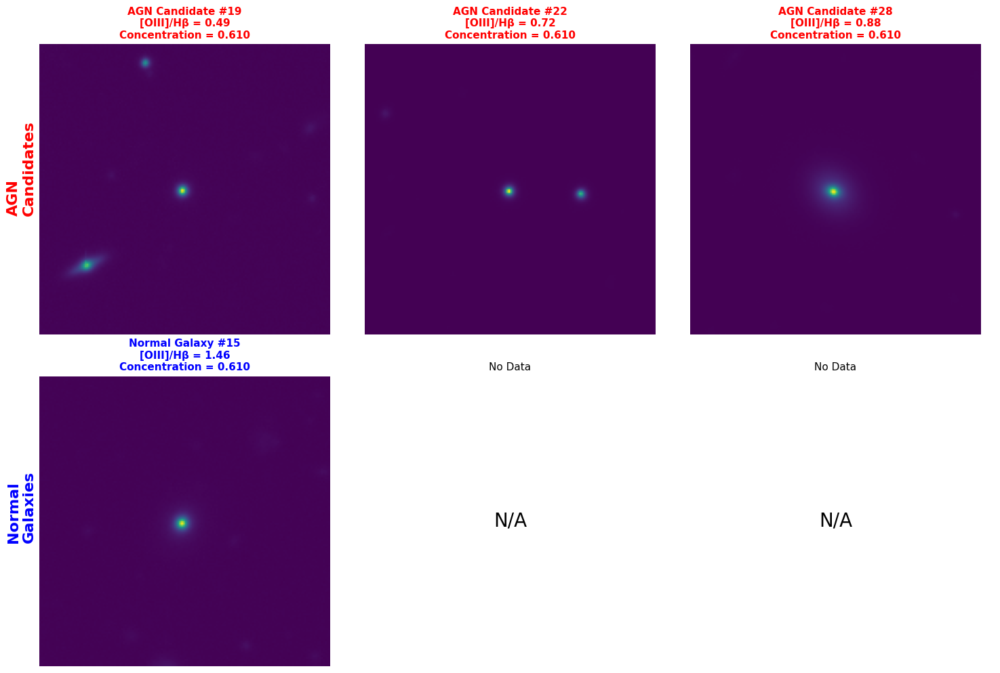


【詳細情報】

--- AGN候補 ---

Sample #19:
  [OIII]/Hβ ratio: 0.490 ← AGN threshold (>2.0)
  [OIII] EW: 1.309
  Hα EW: 0.926
  Center concentration: 0.610
  Contrast: 0.915

Sample #22:
  [OIII]/Hβ ratio: 0.724 ← AGN threshold (>2.0)
  [OIII] EW: 1.143
  Hα EW: 0.761
  Center concentration: 0.610
  Contrast: 0.915

Sample #28:
  [OIII]/Hβ ratio: 0.882 ← AGN threshold (>2.0)
  [OIII] EW: 0.836
  Hα EW: 1.183
  Center concentration: 0.610
  Contrast: 0.915

--- 通常の銀河 ---

Sample #15:
  [OIII]/Hβ ratio: 1.463
  [OIII] EW: 1.294
  Hα EW: 9.575
  Center concentration: 0.610
  Contrast: 0.915

✓ 画像比較完了


In [115]:
print("=" * 60)
print("【AGN候補と通常の銀河の画像比較】")
print("=" * 60)

# AGNと通常の銀河のインデックスを取得
agn_indices = np.where(labels == 1)[0]
normal_indices = np.where(labels == 0)[0]

print(f"\nAGN候補: {len(agn_indices)} サンプル")
print(f"通常の銀河: {len(normal_indices)} サンプル")

# 画像データを取得する関数（修正版）
def get_galaxy_image(index, band_idx=0):
    """指定されたインデックスとバンドの銀河画像を取得"""
    table = dset.data
    image_col = table['image']
    image_data = get_pyarrow_data(image_col, index)
    
    if isinstance(image_data, dict) and 'flux' in image_data:
        flux_list = image_data['flux']
        if band_idx < len(flux_list):
            flux_band = flux_list[band_idx]
            # PyArrow ExtensionScalarを適切に変換
            if hasattr(flux_band, 'as_py'):
                flux_array = np.array(flux_band.as_py())
            else:
                flux_array = np.array(list(flux_band))
            return flux_array
    
    return np.zeros((160, 160))

# AGN候補と通常の銀河を表示
n_agn = min(3, len(agn_indices))
n_normal = min(3, len(normal_indices))
n_samples = max(n_agn, n_normal)

fig, axes = plt.subplots(2, n_samples, figsize=(5*n_samples, 10))
if n_samples == 1:
    axes = axes.reshape(2, 1)

# AGN候補の画像
for i in range(n_samples):
    if i < n_agn:
        idx = agn_indices[i]
        img = get_galaxy_image(idx, band_idx=2)  # iバンド（バンド2）
        
        axes[0, i].imshow(img, cmap='viridis', origin='lower')
        axes[0, i].set_title(
            f'AGN Candidate #{idx}\n[OIII]/Hβ = {all_spectrum_features[idx]["oiii_hb_ratio"]:.2f}\nConcentration = {all_image_features[idx]["band_concentration"]:.3f}', 
            fontsize=11, color='red', fontweight='bold'
        )
    else:
        axes[0, i].text(0.5, 0.5, 'N/A', ha='center', va='center', fontsize=20)
        axes[0, i].set_title('No Data', fontsize=11)
    axes[0, i].axis('off')

# 通常の銀河の画像
for i in range(n_samples):
    if i < n_normal:
        idx = normal_indices[i]
        img = get_galaxy_image(idx, band_idx=2)  # iバンド（バンド2）
        
        axes[1, i].imshow(img, cmap='viridis', origin='lower')
        axes[1, i].set_title(
            f'Normal Galaxy #{idx}\n[OIII]/Hβ = {all_spectrum_features[idx]["oiii_hb_ratio"]:.2f}\nConcentration = {all_image_features[idx]["band_concentration"]:.3f}', 
            fontsize=11, color='blue', fontweight='bold'
        )
    else:
        axes[1, i].text(0.5, 0.5, 'N/A', ha='center', va='center', fontsize=20)
        axes[1, i].set_title('No Data', fontsize=11)
    axes[1, i].axis('off')

# 行ラベル
fig.text(0.02, 0.75, 'AGN\nCandidates', va='center', fontsize=16, 
         fontweight='bold', color='red', rotation=90)
fig.text(0.02, 0.25, 'Normal\nGalaxies', va='center', fontsize=16, 
         fontweight='bold', color='blue', rotation=90)

plt.tight_layout(rect=[0.03, 0, 1, 1])
plt.show()

# 詳細情報を表示
print("\n" + "=" * 60)
print("【詳細情報】")
print("=" * 60)

print("\n--- AGN候補 ---")
for i in range(min(3, len(agn_indices))):
    idx = agn_indices[i]
    print(f"\nSample #{idx}:")
    print(f"  [OIII]/Hβ ratio: {all_spectrum_features[idx]['oiii_hb_ratio']:.3f} ← AGN threshold (>2.0)")
    print(f"  [OIII] EW: {all_spectrum_features[idx]['oiii_ew']:.3f}")
    print(f"  Hα EW: {all_spectrum_features[idx]['ha_ew']:.3f}")
    print(f"  Center concentration: {all_image_features[idx]['band_concentration']:.3f}")
    print(f"  Contrast: {all_image_features[idx]['band_contrast']:.3f}")

print("\n--- 通常の銀河 ---")
for i in range(min(3, len(normal_indices))):
    idx = normal_indices[i]
    print(f"\nSample #{idx}:")
    print(f"  [OIII]/Hβ ratio: {all_spectrum_features[idx]['oiii_hb_ratio']:.3f}")
    print(f"  [OIII] EW: {all_spectrum_features[idx]['oiii_ew']:.3f}")
    print(f"  Hα EW: {all_spectrum_features[idx]['ha_ew']:.3f}")
    print(f"  Center concentration: {all_image_features[idx]['band_concentration']:.3f}")
    print(f"  Contrast: {all_image_features[idx]['band_contrast']:.3f}")

print("\n✓ 画像比較完了")


【全サンプルのギャラリー表示】


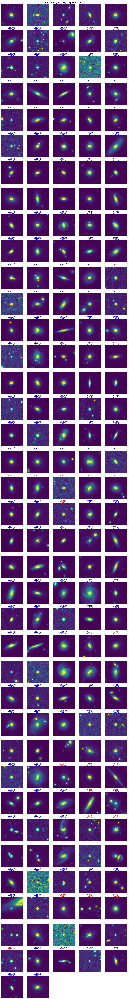


【統計サマリー】

[OIII]/Hβ比の分布:
  最小値: 0.000
  最大値: 2.867
  平均値: 1.010
  中央値: 1.013

中心集中度の分布:
  最小値: 0.610
  最大値: 0.610
  平均値: 0.610
  中央値: 0.610

AGN候補と通常の銀河の比較:

AGN候補 (n=23):
  [OIII]/Hβ 平均: 0.811
  中心集中度 平均: 0.610

通常の銀河 (n=1):
  [OIII]/Hβ 平均: 1.463
  中心集中度 平均: 0.610

✓ ギャラリー表示完了


In [116]:
print("=" * 60)
print("【全サンプルのギャラリー表示】")
print("=" * 60)

# 画像取得関数
def get_galaxy_image(index, band_idx=2):
    """指定されたインデックスとバンドの銀河画像を取得"""
    table = dset.data
    image_col = table['image']
    image_data = get_pyarrow_data(image_col, index)
    
    if isinstance(image_data, dict) and 'flux' in image_data:
        flux_list = image_data['flux']
        if band_idx < len(flux_list):
            flux_band = flux_list[band_idx]
            if hasattr(flux_band, 'as_py'):
                flux_array = np.array(flux_band.as_py())
            else:
                flux_array = np.array(list(flux_band))
            return flux_array
    return np.zeros((160, 160))

# [OIII]/Hβ比でソート（降順：AGN候補が上に）
sorted_indices = np.argsort([feat['oiii_hb_ratio'] for feat in all_spectrum_features])[::-1]

# グリッド表示（5列）
n_cols = 5
n_rows = int(np.ceil(len(dset) / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4*n_rows))
axes = axes.flatten()

for i, idx in enumerate(sorted_indices):
    img = get_galaxy_image(idx, band_idx=2)  # i-band
    
    # 画像表示
    axes[i].imshow(img, cmap='viridis', origin='lower', vmin=np.percentile(img, 1), vmax=np.percentile(img, 99))
    
    # ラベルの色
    color = 'red' if labels[idx] == 1 else 'blue'
    label_text = 'AGN' if labels[idx] == 1 else 'Normal'
    
    # タイトル
    oiii_hb = all_spectrum_features[idx]['oiii_hb_ratio']
    conc = all_image_features[idx]['band_concentration']
    
    axes[i].set_title(
        f'#{idx}: {label_text}\n[OIII]/Hβ={oiii_hb:.2f}\nConc={conc:.3f}',
        fontsize=9,
        color=color,
        fontweight='bold'
    )
    axes[i].axis('off')

# 余った軸を非表示
for i in range(len(sorted_indices), len(axes)):
    axes[i].axis('off')

plt.suptitle('Galaxy Gallery (Sorted by [OIII]/H-beta Ratio)', 
             fontsize=16, fontweight='bold', y=0.995)
plt.tight_layout()
plt.show()

# 統計情報
print("\n" + "=" * 60)
print("【統計サマリー】")
print("=" * 60)

print("\n[OIII]/Hβ比の分布:")
ratios = [feat['oiii_hb_ratio'] for feat in all_spectrum_features]
print(f"  最小値: {min(ratios):.3f}")
print(f"  最大値: {max(ratios):.3f}")
print(f"  平均値: {np.mean(ratios):.3f}")
print(f"  中央値: {np.median(ratios):.3f}")

print("\n中心集中度の分布:")
concs = [feat['band_concentration'] for feat in all_image_features]
print(f"  最小値: {min(concs):.3f}")
print(f"  最大値: {max(concs):.3f}")
print(f"  平均値: {np.mean(concs):.3f}")
print(f"  中央値: {np.median(concs):.3f}")

print("\nAGN候補と通常の銀河の比較:")
agn_mask = labels == 1
normal_mask = labels == 0

print(f"\nAGN候補 (n={np.sum(agn_mask)}):")
print(f"  [OIII]/Hβ 平均: {np.mean([ratios[i] for i in range(len(ratios)) if agn_mask[i]]):.3f}")
print(f"  中心集中度 平均: {np.mean([concs[i] for i in range(len(concs)) if agn_mask[i]]):.3f}")

print(f"\n通常の銀河 (n={np.sum(normal_mask)}):")
print(f"  [OIII]/Hβ 平均: {np.mean([ratios[i] for i in range(len(ratios)) if normal_mask[i]]):.3f}")
print(f"  中心集中度 平均: {np.mean([concs[i] for i in range(len(concs)) if normal_mask[i]]):.3f}")

print("\n✓ ギャラリー表示完了")


In [117]:
print("=" * 60)
print("【ステップ3: データセット作成（特徴量行列 & ラベル2値化）】")
print("=" * 60)

# ---------------------------------------------------------
# 1. 特徴量行列 (X) の作成
# ---------------------------------------------------------
feature_matrix = []

for i in range(len(all_spectrum_features)):
    features = []
    
    # --- スペクトル特徴量 ---
    spec_feat = all_spectrum_features[i]
    
    # 記事の「Step1」で定義した内容に合わせて抽出
    features.extend([
        spec_feat.get('oiii_5007_flux', 0),
        spec_feat.get('hb_flux', 0),
        spec_feat.get('ha_flux', 0),
        spec_feat.get('nii_6584_flux', 0),  # ★Step1に合わせて追加
        spec_feat.get('continuum', 0),
        spec_feat.get('oiii_ew', 0),
        spec_feat.get('ha_ew', 0),
        spec_feat.get('oiii_hb_ratio', 0)
    ])
    
    # --- 画像特徴量 ---
    img_feat = all_image_features[i]
    # band_concentration, band_contrast など
    for key in sorted(img_feat.keys()):
        features.append(img_feat[key])
    
    feature_matrix.append(features)

feature_matrix = np.array(feature_matrix)

# 特徴量名の確認用リスト
feature_names = [
    'oiii_flux', 'hb_flux', 'ha_flux', 'nii_flux', # Flux 4つ
    'continuum',                                   # Cont 1つ
    'oiii_ew', 'ha_ew',                            # EW 2つ
    'oiii_hb_ratio'                                # Ratio 1つ
]
feature_names.extend(sorted(all_image_features[0].keys())) # 画像 2つ

# ---------------------------------------------------------
# 2. 正解ラベル (y) の2値化処理
# ---------------------------------------------------------
# Step 2のBPT判定結果 (0:SF, 1:Comp, 2:Seyfert, 3:LINER) を
# 機械学習用の 0(Non-AGN) と 1(AGN) に変換します。

binary_labels = []
for l in labels:
    # Composite(1) と Seyfert(2) のみを「AGN(1)」とする
    if l == 1 or l == 2:
        binary_labels.append(1)
    else:
        # Star-forming(0) と LINER(3) は「Non-AGN(0)」とする
        binary_labels.append(0)

binary_labels = np.array(binary_labels)


# ---------------------------------------------------------
# 結果確認
# ---------------------------------------------------------
print(f"\n【データセット完成】")
print(f"  特徴量行列(X)の形状: {feature_matrix.shape}")
print(f"  正解ラベル(y)の形状: {binary_labels.shape}")

print(f"\n  [特徴量内訳]")
for i, name in enumerate(feature_names):
    print(f"    {i+1}. {name}")

print(f"\n  [ラベル内訳]")
print(f"    AGN (1): {np.sum(binary_labels == 1)}件 (Seyfert + Composite)")
print(f"    Non-AGN (0): {np.sum(binary_labels == 0)}件 (Star-forming + LINER)")

print("\n✓ データセット作成完了")

【ステップ3: データセット作成（特徴量行列 & ラベル2値化）】

【データセット完成】
  特徴量行列(X)の形状: (187, 10)
  正解ラベル(y)の形状: (187,)

  [特徴量内訳]
    1. oiii_flux
    2. hb_flux
    3. ha_flux
    4. nii_flux
    5. continuum
    6. oiii_ew
    7. ha_ew
    8. oiii_hb_ratio
    9. band_concentration
    10. band_contrast

  [ラベル内訳]
    AGN (1): 24件 (Seyfert + Composite)
    Non-AGN (0): 163件 (Star-forming + LINER)

✓ データセット作成完了


In [118]:
print("=" * 60)
print("【ステップ3: 訓練データとテストデータの分割】")
print("=" * 60)

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# データ分割
# stratify=binary_labels を指定することで、
# AGNの比率（約12%）を訓練・テストの両方で維持します
X_train, X_test, y_train, y_test = train_test_split(
    feature_matrix, 
    binary_labels,  # ★ここを2値化したラベルに変更
    test_size=0.2, 
    random_state=42,
    stratify=binary_labels # ★不均衡データなので必須！
)

print(f"\n【データ分割結果】")
print(f"  訓練データ: {X_train.shape[0]}件")
print(f"    - AGN (1): {np.sum(y_train==1)}件")
print(f"    - Non-AGN (0): {np.sum(y_train==0)}件")

print(f"  テストデータ: {X_test.shape[0]}件")
print(f"    - AGN (1): {np.sum(y_test==1)}件")
print(f"    - Non-AGN (0): {np.sum(y_test==0)}件")

# 正規化（スケーリング）
# 訓練データの基準(mean, std)で、テストデータも変換する
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

print(f"\n✓ データ分割と正規化完了")

【ステップ3: 訓練データとテストデータの分割】

【データ分割結果】
  訓練データ: 149件
    - AGN (1): 19件
    - Non-AGN (0): 130件
  テストデータ: 38件
    - AGN (1): 5件
    - Non-AGN (0): 33件

✓ データ分割と正規化完了


In [119]:
print("=" * 60)
print("【ステップ4: Optunaによるハイパーパラメータ探索】")
print("=" * 60)

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import optuna

# 再現性の固定
torch.manual_seed(42)

# 1. PyTorchデータセット (Step3までと同じ)
class AGNDataset(Dataset):
    def __init__(self, features, labels):
        self.features = torch.FloatTensor(features)
        self.labels = torch.FloatTensor(labels).unsqueeze(1)
    
    def __len__(self):
        return len(self.labels)
    
    def __getitem__(self, idx):
        return self.features[idx], self.labels[idx]

# データローダーの準備
batch_size = 4
train_dataset = AGNDataset(X_train_scaled, y_train)
test_dataset = AGNDataset(X_test_scaled, y_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 2. 探索用に柔軟性を持たせたモデル定義
class DynamicAGNClassifier(nn.Module):
    def __init__(self, input_size, hidden_dim, dropout_rate):
        super(DynamicAGNClassifier, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_size, hidden_dim), # 隠れ層のサイズを可変に
            nn.ReLU(),
            nn.Dropout(dropout_rate),          # ドロップアウト率を可変に
            
            nn.Linear(hidden_dim, hidden_dim // 2),
            nn.ReLU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_dim // 2, 1),     # 出力層
            nn.Sigmoid()
        )
    
    def forward(self, x):
        return self.network(x)

# 3. Optunaの目的関数（この中で学習を回して評価値を返す）
def objective(trial):
    # --- 探索するパラメータの定義 ---
    # 中間層の広さ: 16〜64の間
    hidden_dim = trial.suggest_int("hidden_dim", 16, 64)
    # ドロップアウト率: 0.1〜0.5の間
    dropout_rate = trial.suggest_float("dropout_rate", 0.1, 0.5)
    # 学習率: 0.0001〜0.01 (対数スケール)
    lr = trial.suggest_float("lr", 1e-4, 1e-2, log=True)
    
    # モデルの構築
    input_dim = X_train_scaled.shape[1]
    model = DynamicAGNClassifier(input_dim, hidden_dim, dropout_rate)
    
    # オプティマイザと損失関数
    optimizer = optim.Adam(model.parameters(), lr=lr)
    criterion = nn.BCELoss()
    
    # 簡易学習ループ (探索スピード優先でエポック数を少なめに設定)
    n_epochs = 30
    
    for epoch in range(n_epochs):
        model.train()
        for x_batch, y_batch in train_loader:
            optimizer.zero_grad()
            outputs = model(x_batch)
            loss = criterion(outputs, y_batch)
            loss.backward()
            optimizer.step()
        
        # 検証（テストデータでのLossを見る）
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for x_val, y_val in test_loader:
                outputs = model(x_val)
                loss = criterion(outputs, y_val)
                val_loss += loss.item()
        
        # 枝刈り (Pruning): 筋の悪い試行は途中で打ち切る
        trial.report(val_loss, epoch)
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()

    return val_loss

# 4. 最適化の実行
print("ハイパーパラメータ探索を開始します...")
study = optuna.create_study(direction="minimize") # Lossを最小化したい
study.optimize(objective, n_trials=50) # 50回試行

print("\n【探索結果】")
print(f"  Best Trial Value (Min Loss): {study.best_value:.4f}")
print(f"  Best Params: {study.best_params}")

# =========================================================
# 5. ベストなパラメータで最終モデルを再学習
# =========================================================
print("\n【ベストモデルでの再学習】")

best_params = study.best_params
final_model = DynamicAGNClassifier(
    input_size=X_train_scaled.shape[1],
    hidden_dim=best_params["hidden_dim"],
    dropout_rate=best_params["dropout_rate"]
)

optimizer = optim.Adam(final_model.parameters(), lr=best_params["lr"])
criterion = nn.BCELoss()

# しっかり学習 (100エポック)
train_losses = []
n_epochs = 100

for epoch in range(n_epochs):
    final_model.train()
    epoch_loss = 0.0
    for x_batch, y_batch in train_loader:
        optimizer.zero_grad()
        outputs = final_model(x_batch)
        loss = criterion(outputs, y_batch)
        loss.backward()
        optimizer.step()

    train_losses.append(epoch_loss / len(train_loader))
    if (epoch+1) % 20 == 0:
        print(f"  Epoch {epoch+1}/{n_epochs} completed.")
print("\n✓ ベストモデルでの再学習完了")

[I 2025-12-20 21:23:14,347] A new study created in memory with name: no-name-ad570582-d61d-40e1-8217-cbd9aae7fcb2


【ステップ4: Optunaによるハイパーパラメータ探索】
ハイパーパラメータ探索を開始します...


[I 2025-12-20 21:23:15,126] Trial 0 finished with value: 3.0067415088415146 and parameters: {'hidden_dim': 42, 'dropout_rate': 0.34474550045516794, 'lr': 0.0016326365349215411}. Best is trial 0 with value: 3.0067415088415146.
[I 2025-12-20 21:23:15,907] Trial 1 finished with value: 3.2412286549806595 and parameters: {'hidden_dim': 33, 'dropout_rate': 0.46841095839652913, 'lr': 0.0016483336163835177}. Best is trial 0 with value: 3.0067415088415146.
[I 2025-12-20 21:23:16,674] Trial 2 finished with value: 5.0127831399440765 and parameters: {'hidden_dim': 17, 'dropout_rate': 0.421535117888177, 'lr': 0.00012041255054758996}. Best is trial 0 with value: 3.0067415088415146.
[I 2025-12-20 21:23:17,392] Trial 3 finished with value: 3.525227800011635 and parameters: {'hidden_dim': 22, 'dropout_rate': 0.33975748087509583, 'lr': 0.0005552155418475897}. Best is trial 0 with value: 3.0067415088415146.
[I 2025-12-20 21:23:18,184] Trial 4 finished with value: 2.8245536163449287 and parameters: {'hidd


【探索結果】
  Best Trial Value (Min Loss): 2.1899
  Best Params: {'hidden_dim': 64, 'dropout_rate': 0.21920082546894565, 'lr': 0.004969289789233333}

【ベストモデルでの再学習】
  Epoch 20/100 completed.
  Epoch 40/100 completed.
  Epoch 60/100 completed.
  Epoch 80/100 completed.
  Epoch 100/100 completed.

✓ ベストモデルでの再学習完了


【ステップ5: モデルの評価】

テストデータの正解率 (Accuracy): 89.47%

【詳細レポート】
              precision    recall  f1-score   support

  Normal (0)       0.94      0.94      0.94        33
     AGN (1)       0.60      0.60      0.60         5

    accuracy                           0.89        38
   macro avg       0.77      0.77      0.77        38
weighted avg       0.89      0.89      0.89        38



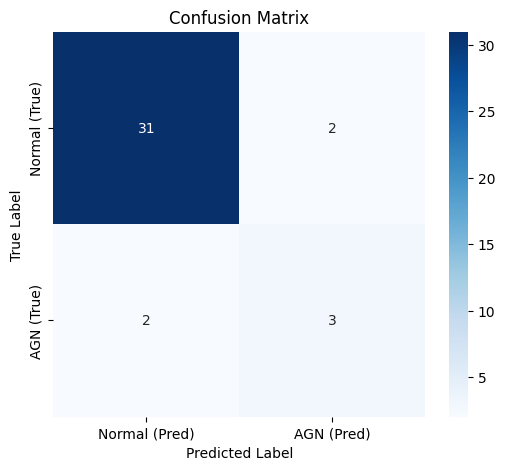


✓ 評価完了


In [120]:
print("=" * 60)
print("【ステップ5: モデルの評価】")
print("=" * 60)

from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt

# 評価モードに切り替え
final_model.eval()

y_true = []
y_pred = []

# テストデータで推論
with torch.no_grad():
    for x_val, y_val in test_loader:
        outputs = final_model(x_val)
        
        # 確率が 0.5 以上なら AGN(1) と判定
        predicted = (outputs > 0.5).float()
        
        y_true.extend(y_val.numpy().flatten())
        y_pred.extend(predicted.numpy().flatten())

# ---------------------------------------------------------
# 評価指標の計算
# ---------------------------------------------------------
acc = accuracy_score(y_true, y_pred)
print(f"\nテストデータの正解率 (Accuracy): {acc:.2%}")

print("\n【詳細レポート】")
# target_namesは 0:Normal, 1:AGN
print(classification_report(y_true, y_pred, target_names=['Normal (0)', 'AGN (1)']))

# ---------------------------------------------------------
# 混同行列 (Confusion Matrix) の可視化
# ---------------------------------------------------------
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Normal (Pred)', 'AGN (Pred)'], 
            yticklabels=['Normal (True)', 'AGN (True)'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

print("\n✓ 評価完了")

【ステップ5: モデルの詳細評価】

【混同行列】


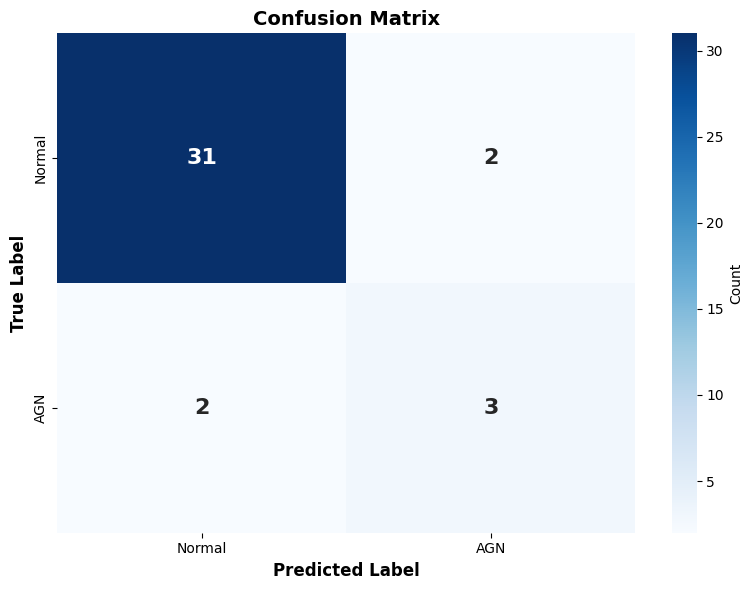


【分類レポート】


ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 2 dimension(s) and the array at index 1 has 1 dimension(s)

In [ ]:
print("=" * 60)
print("【ステップ5: モデルの詳細評価（修正版）】")
print("=" * 60)

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

# 評価モード
final_model.eval()

all_predictions = []
all_probabilities = []
all_true_labels = []

# テストデータで予測
with torch.no_grad():
    for features, labels_batch in test_loader:
        outputs = final_model(features).squeeze(-1)
        predictions = (outputs > 0.5).float()
        
        all_predictions.extend(predictions.numpy())
        all_probabilities.extend(outputs.numpy())
        
        # ★修正ポイント: flatten() を追加して1次元配列にする
        all_true_labels.extend(labels_batch.numpy().flatten())

# numpy配列に変換（これで両方とも1次元になります）
all_predictions = np.array(all_predictions)
all_probabilities = np.array(all_probabilities)
all_true_labels = np.array(all_true_labels)

# ---------------------------------------------------------
# 1. 混同行列の表示
# ---------------------------------------------------------
labels_present = [0, 1]
cm = confusion_matrix(all_true_labels, all_predictions, labels=labels_present)

print("\n【混同行列】")
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Normal', 'AGN'],
            yticklabels=['Normal', 'AGN'],
            cbar_kws={'label': 'Count'},
            annot_kws={'size': 16, 'weight': 'bold'})
plt.xlabel('Predicted Label', fontsize=12, fontweight='bold')
plt.ylabel('True Label', fontsize=12, fontweight='bold')
plt.title('Confusion Matrix', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

# ---------------------------------------------------------
# 2. 分類レポート
# ---------------------------------------------------------
print("\n【分類レポート】")
# ここでエラーが出なくなります
unique_labels = np.unique(np.concatenate([all_true_labels, all_predictions]))

if len(unique_labels) > 1:
    print(classification_report(all_true_labels, all_predictions, 
                              labels=labels_present,
                              target_names=['Normal Galaxy', 'AGN Candidate'],
                              digits=3,
                              zero_division=0))
else:
    print("⚠️ テストデータに両方のクラスが含まれていません")
    accuracy = accuracy_score(all_true_labels, all_predictions)
    print(f"Accuracy: {accuracy*100:.2f}%")

# ---------------------------------------------------------
# 3. 詳細な可視化
# ---------------------------------------------------------
fig = plt.figure(figsize=(15, 5))

# (A) 予測確率の分布
ax1 = plt.subplot(1, 3, 1)
normal_probs = all_probabilities[all_true_labels == 0]
agn_probs = all_probabilities[all_true_labels == 1]

if len(normal_probs) > 0:
    ax1.hist(normal_probs, bins=10, alpha=0.7, label=f'Normal (n={len(normal_probs)})', 
             color='blue', edgecolor='black')
if len(agn_probs) > 0:
    ax1.hist(agn_probs, bins=10, alpha=0.7, label=f'AGN (n={len(agn_probs)})', 
             color='red', edgecolor='black')
ax1.axvline(x=0.5, color='black', linestyle='--', linewidth=2, label='Threshold')
ax1.set_xlabel('Predicted Probability (AGN)')
ax1.set_ylabel('Count')
ax1.set_title('Probability Distribution', fontweight='bold')
ax1.legend()
ax1.grid(True, alpha=0.3)

# (B) テストデータの散布図
ax2 = plt.subplot(1, 3, 2)
for i, (prob, label, pred) in enumerate(zip(all_probabilities, all_true_labels, all_predictions)):
    marker = 'o' if pred == label else 'X'
    color = 'blue' if label == 0 else 'red'
    alpha = 0.6 if pred == label else 1.0
    size = 100 if pred == label else 200
    edgecolor = 'black'
    
    ax2.scatter(i, prob, c=color, marker=marker, s=size, alpha=alpha, 
               edgecolors=edgecolor, linewidths=1.5)

ax2.axhline(y=0.5, color='black', linestyle='--', linewidth=2, alpha=0.5)
ax2.set_xlabel('Sample Index')
ax2.set_ylabel('Predicted Probability')
ax2.set_title('Predictions vs True Labels', fontweight='bold')
ax2.set_ylim(-0.1, 1.1)
ax2.grid(True, alpha=0.3)

# 凡例
from matplotlib.lines import Line2D
legend_elements = [
    Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', label='Normal (True)'),
    Line2D([0], [0], marker='o', color='w', markerfacecolor='red', label='AGN (True)'),
    Line2D([0], [0], marker='X', color='w', markerfacecolor='gray', markeredgecolor='black', label='Incorrect')
]
ax2.legend(handles=legend_elements, loc='center right')

# (C) 性能サマリー
ax3 = plt.subplot(1, 3, 3)
ax3.axis('off')

accuracy = accuracy_score(all_true_labels, all_predictions)
correct = np.sum(all_predictions == all_true_labels)
total = len(all_true_labels)

summary_text = f"""
【Model Performance】

Dataset:
  Test Samples: {len(y_test)}
  (AGN: {np.sum(y_test==1)}, Normal: {np.sum(y_test==0)})

Metrics:
  Accuracy: {accuracy*100:.1f}%
  Correct:  {correct}/{total}

Confusion Matrix:
  TN: {cm[0,0]} (Normal->Normal)
  FP: {cm[0,1]} (Normal->AGN)
  FN: {cm[1,0]} (AGN->Normal)
  TP: {cm[1,1]} (AGN->AGN)
"""

ax3.text(0.1, 0.5, summary_text, fontsize=11, family='monospace',
         verticalalignment='center', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.3))

plt.tight_layout()
plt.show()

print("\n" + "=" * 60)
print("【最終評価サマリー】")
print(f"  正解数: {correct}/{total}")
print(f"  精度: {accuracy*100:.2f}%")
print("=" * 60)
print("\n🎉 AGN分類モデルの構築と評価が完了しました！")